### Finding
* Pay attention to /players/p/pierza.01.shtml only player id with "."
* 681 unduplicated batters >= 162 PA between 2015 and 2019
* 1925 data points >= 162 PA between 2015 and 2019
* Some % data are string data type = >need to convert if be used

### Completed
* Web-scraping on baseball reference by year to get the list of 2015-2019 batters
* Web-scraping on baseball reference by players to get advance stats
* Data frame
* Data into sql database

### To do
* Merge Baseball Reference data with Baseball Savant data
* EDA
* Decide baseline features

In [133]:
from sqlalchemy import create_engine
from sqlalchemy import inspect
import pandas as pd
import numpy as np

In [2]:
engine = create_engine('sqlite:///batters.db')

In [3]:
inspect(engine).get_table_names()

['br', 'players', 'statcast']

In [128]:
pd.read_sql('SELECT * FROM br;', engine)

,index,Html_id,Name,Year,Age,Tm,Lg,G,PA,AB,...,PA_3y,PA_3y_0,PA_2y,PA_2y_0,OPS+_3y,OPS+_3y_0,OPS+_2y,OPS+_2y_0,OPS+_last,OPS+_next
0,0,pierza.01,A.J. Pierzynski,2015,38,ATL,NL,113,436,407,...,442.333333,470.333333,399.0,445.5,94.000000,96.666667,93.5,85.0,75.0,46.0
1,1,pierza.01,A.J. Pierzynski,2016,39,ATL,NL,81,259,247,...,352.333333,442.333333,347.5,399.0,77.666667,94.000000,79.0,93.5,112.0,NaN
2,2,/players/m/machama01.shtml,Manny Machado,2015,22,BAL,AL,162,713,633,...,592.333333,422.000000,533.5,532.0,114.666667,103.333333,121.0,106.0,110.0,130.0
3,3,/players/m/machama01.shtml,Manny Machado,2016,23,BAL,AL,157,696,640,...,587.666667,592.333333,704.5,533.5,124.000000,114.666667,131.0,121.0,132.0,108.0
4,4,/players/m/machama01.shtml,Manny Machado,2017,24,BAL,AL,156,690,630,...,699.666667,587.666667,693.0,704.5,123.333333,124.000000,119.0,131.0,130.0,145.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1920,1920,/players/h/holadbr01.shtml,Bryan Holaday,2018,30,MIA,NL,61,166,151,...,108.000000,74.333333,97.5,79.0,52.666667,71.666667,45.5,56.5,46.0,105.0
1921,1921,/players/t/thaisma01.shtml,Matt Thaiss,2019,24,LAA,AL,53,164,147,...,164.000000,NaN,164.0,NaN,87.000000,NaN,87.0,NaN,NaN,56.0
1922,1922,/players/j/jonesry01.shtml,Ryder Jones,2017,23,SFG,NL,53,164,150,...,164.000000,NaN,164.0,NaN,37.000000,NaN,37.0,NaN,NaN,297.0
1923,1923,/players/f/fordmi01.shtml,Mike Ford,2019,26,NYY,AL,50,163,143,...,163.000000,NaN,163.0,NaN,137.000000,NaN,137.0,NaN,NaN,38.0


In [7]:
pd.read_sql('SELECT * FROM statcast;', engine)

,index,last_name,first_name,player_id,year,player_age,b_total_pa,b_total_hits,b_home_run,b_total_pitches,...,meatball_percent,iz_contact_percent,in_zone_percent,whiff_percent,swing_percent,f_strike_percent,popups_percent,hp_to_1b,sprint_speed,Unnamed: 33
0,0,Ortiz,David,120074,2016,41,626,169,38,2478,...,4.5,87.4,40.4,19.2,43.5,52.0,8.7,4.75,23.5,None
1,1,Rodriguez,Alex,121347,2016,41,243,45,9,915,...,7.9,76.1,48.1,29.6,49.1,60.9,8.1,4.79,23.9,None
2,2,Beltre,Adrian,134181,2016,37,640,175,32,2443,...,6.9,89.2,47.2,15.2,48.7,60.3,9.6,4.54,25.9,None
3,3,Beltran,Carlos,136860,2016,39,593,163,29,2188,...,6.9,87.2,45.4,19.6,45.6,58.5,8.8,4.47,25.7,None
4,4,Werth,Jayson,150029,2016,37,606,128,21,2785,...,7.9,83.8,51.7,20.9,38.1,56.8,6.9,4.61,25.7,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1920,2522,Bader,Harrison,664056,2018,24,427,100,12,1772,...,7.3,78.7,49.9,28.1,45.3,59.5,8.5,4.07,30.1,None
1921,2523,Fletcher,David,664058,2018,24,307,78,1,1175,...,9.6,94.6,53.0,10.1,40.4,62.2,9.0,4.24,28.1,None
1922,2524,Kingery,Scott,664068,2018,24,484,102,8,1964,...,9.6,74.9,53.3,28.6,51.4,68.2,7.9,4.10,29.4,None
1923,2525,Soto,Juan,665742,2018,20,494,121,22,2031,...,7.2,80.6,48.3,22.1,39.0,57.5,5.1,4.21,27.2,None


In [328]:
pd.read_sql('SELECT * FROM br;', engine).columns

Index(['index', 'Unnamed: 0', 'Html_id', 'Name', 'Year', 'Age', 'Tm', 'Lg',
       'G', 'PA', 'AB', 'R', 'H', '2B', '3B', 'HR', 'RBI', 'SB', 'CS', 'BB',
       'SO', 'BA', 'OBP', 'SLG', 'OPS', 'OPS+', 'TB', 'GDP', 'HBP', 'SH', 'SF',
       'IBB', 'Pos_Summary', 'Awards', 'rOBA', 'Rbat+', 'BAbip', 'ISO', 'HR%',
       'SO%', 'BB%', 'EV', 'HardH%', 'LD%', 'GB%', 'FB%', 'GB/FB', 'Pull%',
       'Cent%', 'Oppo%', 'WPA', 'cWPA', 'RE24', 'RS%', 'SB%', 'XBT%', 'XBH%',
       'X/H%', 'SO/W', 'AB/SO', 'AB/HR', 'AB/RBI', 'GO/AO', 'IP%', 'HR/FB',
       'IF/FB', 'PA_cum', 'PA_cum_0', 'MLB_year', 'PA_0', 'PA_3y', 'PA_3y_0',
       'PA_2y', 'PA_2y_0', 'OPS+_3y', 'OPS+_3y_0', 'OPS+_2y', 'OPS+_2y_0',
       'OPS+_last', 'OPS+_next', 'Debut'],
      dtype='object')

In [130]:
pd.read_sql('SELECT * FROM statcast;', engine).columns

Index(['index', 'last_name', 'first_name', 'player_id', 'year', 'player_age',
       'b_total_pa', 'b_total_hits', 'b_home_run', 'b_total_pitches',
       'exit_velocity_avg', 'launch_angle_avg', 'sweet_spot_percent',
       'barrels', 'barrel_batted_rate', 'hard_hit_percent', 'z_swing_percent',
       'z_swing_miss_percent', 'oz_swing_percent', 'oz_swing_miss_percent',
       'oz_contact_percent', 'out_zone_swing_miss', 'out_zone_swing',
       'out_zone_percent', 'meatball_swing_percent', 'meatball_percent',
       'iz_contact_percent', 'in_zone_percent', 'whiff_percent',
       'swing_percent', 'f_strike_percent', 'popups_percent', 'hp_to_1b',
       'sprint_speed', 'Unnamed: 33'],
      dtype='object')

In [379]:
########must run to update############
df = pd.read_sql('''SELECT b.name, s.first_name, s.last_name, b.year, b.mlb_year, b.age, b.debut,
                           b.[ops+_last], b.[ops+_3y_0],
                           b.pa, b.pa_cum_0, b.pa_0, b.pa_2y_0, b.pa_3y_0, 
                           s.b_total_pitches * 1.0 / b.pa [p/pa], 
                           b.ev, b.[hardh%], s.launch_angle_avg, s.sweet_spot_percent,
                           b.[ld%], b.[gb%], b.[fb%], b.[gb/fb], 
                           b.[pull%], b.[cent%], b.[oppo%], 
                            b.[so/w], b.[go/ao], b.[ip%], b.[hr/fb], b.[if/fb],
                           s.z_swing_percent, s.z_swing_miss_percent, s.iz_contact_percent,
                           s.oz_swing_percent, s.oz_swing_miss_percent, s.oz_contact_percent,
                           s.meatball_swing_percent, s.whiff_percent, s.swing_percent,
                           s.popups_percent, s.sprint_speed, b.[ops+]
                     FROM br b
                     JOIN statcast s
                     ON b.year = s.year
                     AND b.pa = s.b_total_pa
                     AND b.h = s.b_total_hits
                     AND b.hr = s.b_home_run;''', engine)#.dropna(how='any') 

#s.hp_to_1b, 

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1925 entries, 0 to 1924
Data columns (total 43 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Name                    1925 non-null   object 
 1   first_name              1925 non-null   object 
 2   last_name               1925 non-null   object 
 3   Year                    1925 non-null   int64  
 4   MLB_year                1925 non-null   int64  
 5   Age                     1925 non-null   int64  
 6   Debut                   1925 non-null   int64  
 7   OPS+_last               1925 non-null   float64
 8   OPS+_3y_0               1925 non-null   float64
 9   PA                      1925 non-null   int64  
 10  PA_cum_0                1925 non-null   int64  
 11  PA_0                    1925 non-null   float64
 12  PA_2y_0                 1925 non-null   float64
 13  PA_3y_0                 1925 non-null   float64
 14  p/pa                    1925 non-null   

In [294]:
df["p/pa"]

0       3.337156
1       3.185328
2       3.911641
3       3.686782
4       3.692754
          ...   
1920    3.759036
1921    4.335366
1922    3.573171
1923    4.030675
1924    4.061728
Name: p/pa, Length: 1925, dtype: float64

In [337]:
df.head(3)

,Name,first_name,last_name,Year,MLB_year,Age,Debut,OPS+_last,OPS+_3y_0,PA,...,oz_swing_percent,oz_swing_miss_percent,oz_contact_percent,meatball_swing_percent,whiff_percent,swing_percent,popups_percent,hp_to_1b,sprint_speed,OPS+
0,A.J. Pierzynski,A.J.,Pierzynski,2015,17,38,0,75.0,96.666667,436,...,39.3,20.0,78.8,83.9,14.2,54.8,5.1,4.81,23.9,112.0
1,A.J. Pierzynski,A.J.,Pierzynski,2016,18,39,0,112.0,94.000000,259,...,43.6,32.1,67.9,81.1,18.3,59.0,5.0,4.65,24.4,46.0
2,Manny Machado,Manny,Machado,2015,3,22,0,110.0,103.333333,713,...,24.8,33.1,66.3,74.5,17.5,43.2,9.1,4.53,27.4,132.0


In [365]:
df.describe()

,Year,MLB_year,Age,Debut,OPS+_last,OPS+_3y_0,PA,PA_cum_0,PA_0,PA_2y_0,...,iz_contact_percent,oz_swing_percent,oz_swing_miss_percent,oz_contact_percent,meatball_swing_percent,whiff_percent,swing_percent,popups_percent,sprint_speed,OPS+
count,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,...,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000
mean,2017.021818,5.182857,28.334026,0.071169,98.634286,97.300693,428.038961,2109.433766,392.977662,380.545974,...,82.868987,28.382597,40.011117,59.394026,76.223481,23.810649,46.981610,7.161091,26.988416,99.023377
std,1.419914,3.870140,3.855108,0.257173,36.883706,33.002469,161.897648,2155.266875,200.984110,189.850191,...,5.467603,6.036085,9.602150,9.542933,7.293349,6.228404,4.993265,3.044674,1.500840,25.361441
min,2015.000000,0.000000,19.000000,0.000000,-100.000000,-100.000000,162.000000,0.000000,0.000000,0.000000,...,62.000000,10.200000,12.500000,23.100000,52.100000,7.800000,32.400000,0.000000,21.800000,11.000000
25%,2016.000000,2.000000,25.000000,0.000000,84.000000,83.333333,280.000000,404.000000,234.000000,233.000000,...,79.300000,24.100000,33.300000,53.000000,71.100000,19.500000,43.500000,5.100000,26.000000,82.000000
50%,2017.000000,4.000000,28.000000,0.000000,100.000000,100.000000,428.000000,1422.000000,415.000000,399.000000,...,83.300000,28.100000,39.700000,59.600000,76.600000,23.700000,46.800000,7.000000,27.100000,98.000000
75%,2018.000000,8.000000,31.000000,0.000000,116.000000,112.666667,568.000000,3140.000000,567.000000,537.000000,...,86.800000,32.300000,46.400000,66.000000,81.300000,28.000000,50.200000,9.000000,28.100000,116.000000
max,2019.000000,21.000000,43.000000,1.000000,559.000000,559.000000,747.000000,11964.000000,745.000000,734.000000,...,96.800000,48.100000,76.900000,87.000000,96.400000,44.000000,62.000000,19.600000,30.900000,198.000000


## EDA

In [237]:
import statsmodels.api as sm
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats

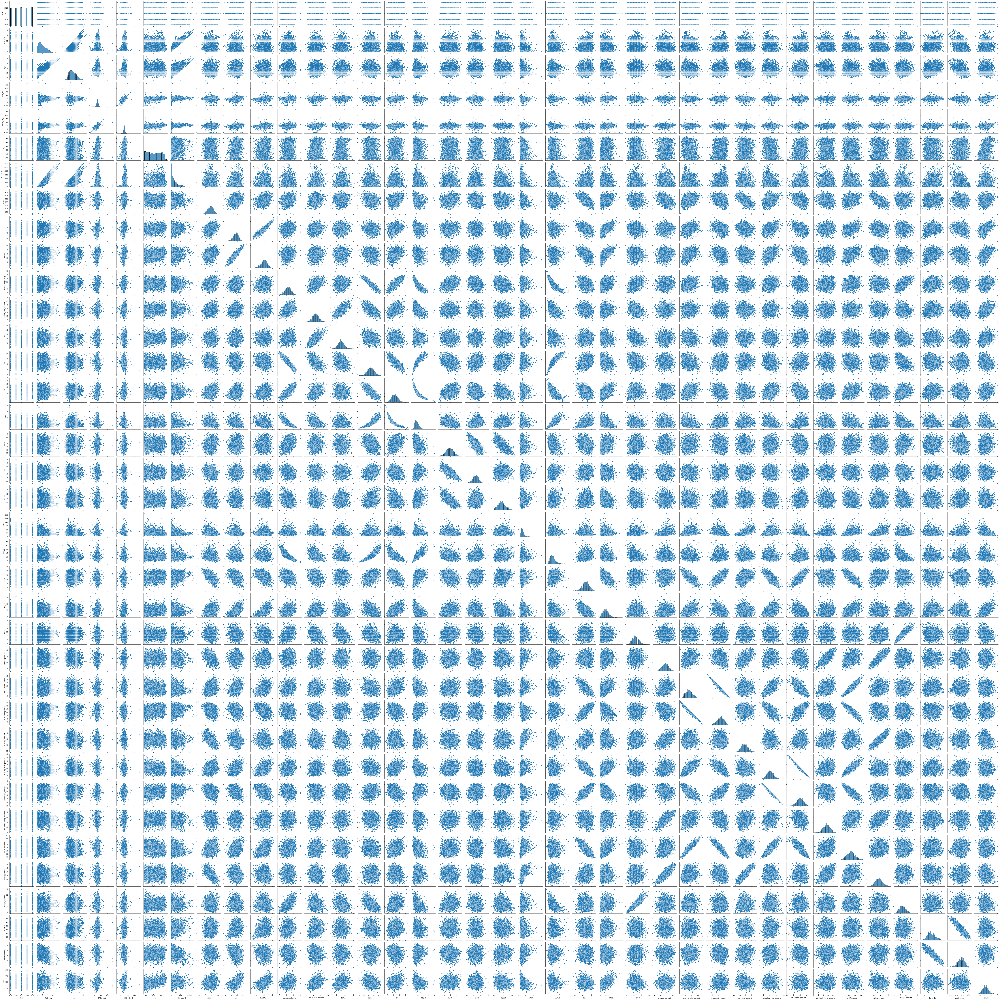

In [278]:
sns.pairplot(df)
plt.savefig("all_pairplot.png", facecolor ="w", bbox_inches="tight");

In [380]:
df.corr()

,Year,MLB_year,Age,Debut,OPS+_last,OPS+_3y_0,PA,PA_cum_0,PA_0,PA_2y_0,...,iz_contact_percent,oz_swing_percent,oz_swing_miss_percent,oz_contact_percent,meatball_swing_percent,whiff_percent,swing_percent,popups_percent,sprint_speed,OPS+
Year,1.000000,-0.044139,-0.043680,0.028482,0.003011,-0.010422,-0.022145,-0.044164,-0.022439,-0.023117,...,-0.117948,-0.044085,0.168790,-0.162063,0.082441,0.151148,0.014469,0.079581,0.035507,-0.002150
MLB_year,-0.044139,1.000000,0.879840,-0.370793,0.101153,0.179639,0.139128,0.927373,0.467650,0.563185,...,0.169663,-0.084110,-0.136299,0.149789,-0.074919,-0.160915,-0.110187,0.002338,-0.446032,-0.011047
Age,-0.043680,0.879840,1.000000,-0.328051,0.072003,0.126273,-0.006986,0.779986,0.337620,0.427148,...,0.167263,-0.132445,-0.124147,0.136022,-0.114708,-0.165843,-0.151459,-0.007319,-0.460350,-0.073393
Debut,0.028482,-0.370793,-0.328051,1.000000,0.010252,0.022646,-0.196316,-0.270991,-0.461411,-0.469839,...,-0.105660,0.000196,0.081554,-0.084221,0.009611,0.096190,0.012191,-0.037284,0.162650,0.028194
OPS+_last,0.003011,0.101153,0.072003,0.010252,1.000000,0.772808,0.279252,0.168213,0.319361,0.285299,...,0.036556,-0.075733,-0.028802,0.044089,0.011409,-0.019218,-0.065616,0.009802,-0.124655,0.255338
OPS+_3y_0,-0.010422,0.179639,0.126273,0.022646,0.772808,1.000000,0.291367,0.272914,0.338616,0.373136,...,0.052880,-0.081616,-0.046161,0.064485,0.023054,-0.034247,-0.073658,0.009321,-0.170138,0.268439
PA,-0.022145,0.139128,-0.006986,-0.196316,0.279252,0.291367,1.000000,0.257455,0.549989,0.536588,...,0.182260,0.029653,-0.201169,0.213392,-0.003481,-0.171407,0.000860,-0.041909,0.048545,0.462122
PA_cum_0,-0.044164,0.927373,0.779986,-0.270991,0.168213,0.272914,0.257455,1.000000,0.546933,0.648332,...,0.212306,-0.062411,-0.185895,0.203221,-0.075765,-0.197252,-0.104420,-0.020402,-0.390294,0.076433
PA_0,-0.022439,0.467650,0.337620,-0.461411,0.319361,0.338616,0.549989,0.546933,1.000000,0.926743,...,0.219834,-0.022081,-0.191564,0.204195,-0.029224,-0.198445,-0.057286,0.008038,-0.149475,0.199713
PA_2y_0,-0.023117,0.563185,0.427148,-0.469839,0.285299,0.373136,0.536588,0.648332,0.926743,1.000000,...,0.232909,-0.029188,-0.199021,0.213128,-0.031678,-0.208153,-0.069587,0.006982,-0.196354,0.207156


In [381]:
df.corr()['OPS+']

Year                     -0.002150
MLB_year                 -0.011047
Age                      -0.073393
Debut                     0.028194
OPS+_last                 0.255338
OPS+_3y_0                 0.268439
PA                        0.462122
PA_cum_0                  0.076433
PA_0                      0.199713
PA_2y_0                   0.207156
PA_3y_0                   0.202956
p/pa                      0.180812
EV                        0.523688
HardH%                    0.520126
launch_angle_avg          0.173162
sweet_spot_percent        0.384819
LD%                       0.272016
GB%                      -0.226747
FB%                       0.251876
GB/FB                    -0.229332
Pull%                     0.113975
Cent%                    -0.038575
Oppo%                    -0.130349
SO/W                     -0.359799
GO/AO                    -0.128500
IP%                      -0.175977
HR/FB                     0.565093
IF/FB                    -0.186571
z_swing_percent     

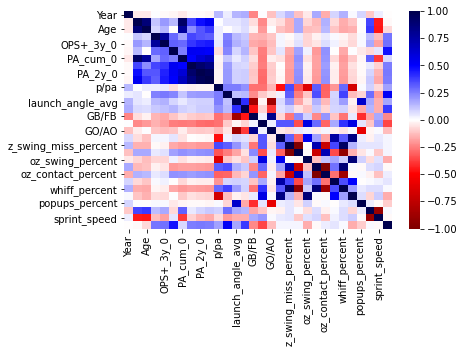

In [298]:
upper = np.triu(df.corr())
sns.heatmap(df.corr(), cmap="seismic_r", annot=False, vmin=-1, vmax=1);

In [157]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [299]:
def vif(df_X):
    '''
    Calculate the VIF for each feature of df_X (a Pandas DataFrame).
    '''
    vif_data = [variance_inflation_factor(df_X.values, i)
                for i in range(df_X.shape[1])]
    
    return pd.Series(vif_data, index=df_X.columns)

In [382]:
vif(df.iloc[:, 4:-1].dropna(how='any'))

MLB_year                     43.530984
Age                         288.093420
Debut                         1.845375
OPS+_last                    22.427787
OPS+_3y_0                    28.899971
PA                           15.836136
PA_cum_0                     24.024949
PA_0                         30.711129
PA_2y_0                     110.826670
PA_3y_0                      89.272711
p/pa                       1000.617922
EV                        10903.867053
HardH%                      210.820604
launch_angle_avg            160.218285
sweet_spot_percent          255.108949
LD%                        1048.110378
GB%                        2681.973969
FB%                         852.467676
GB/FB                        76.873750
Pull%                      3358.929651
Cent%                     10777.668109
Oppo%                      1476.659761
SO/W                         12.968658
GO/AO                        85.600355
IP%                         785.341716
HR/FB                    

In [376]:
df.columns

Index(['Name', 'first_name', 'last_name', 'Year', 'MLB_year', 'Age', 'Debut',
       'OPS+_last', 'OPS+_3y_0', 'PA', 'PA_cum_0', 'PA_0', 'PA_2y_0',
       'PA_3y_0', 'p/pa', 'EV', 'HardH%', 'launch_angle_avg',
       'sweet_spot_percent', 'LD%', 'GB%', 'FB%', 'GB/FB', 'Pull%', 'Cent%',
       'Oppo%', 'SO/W', 'GO/AO', 'IP%', 'HR/FB', 'IF/FB', 'z_swing_percent',
       'z_swing_miss_percent', 'iz_contact_percent', 'oz_swing_percent',
       'oz_swing_miss_percent', 'oz_contact_percent', 'meatball_swing_percent',
       'whiff_percent', 'swing_percent', 'popups_percent', 'sprint_speed',
       'OPS+'],
      dtype='object')

In [186]:
df[['Name', 'first_name']]

,Name,first_name
0,A.J. Pierzynski,A.J.
1,A.J. Pierzynski,A.J.
2,Manny Machado,Manny
3,Manny Machado,Manny
4,Manny Machado,Manny
...,...,...
1920,Bryan Holaday,Bryan
1921,Matt Thaiss,Matt
1922,Ryder Jones,Ryder
1923,Mike Ford,Mike


In [360]:
#text: 'Name', 'first_name', 'last_name', 'Year'
#target: 'OPS+',
#'oz_swing_percent', 'iz_contact_percent': 'swing_percent',
#'oz_swing_percent', : 'oz_swing_miss_percent', 'oz_contact_percent',
#'z_swing_percent': 'z_swing_miss_percent', 'iz_contact_percent',
#'Pull%','Oppo%' : 'Cent%', 
#'HardH%': 'EV',
#'hp_to_1b': , 'sprint_speed'
#0 correlation: , 'hp_to_1b', 'whiff_percent', 

vif(df[[ 'MLB_year', 'Age',
       'OPS+_last', 'OPS+_3y_0', 'PA', 'PA_cum_0', 'p/pa', 'HardH%',
       'launch_angle_avg', 'sweet_spot_percent', 'LD%', 'GB%', 'FB%', 'GB/FB',
       'Pull%', 'Oppo%', 'SO/W', 'GO/AO', 'IP%', 'HR/FB', 'IF/FB',
       'z_swing_percent', 'oz_swing_percent', 
       'meatball_swing_percent', 
       'popups_percent']].dropna(how='any'))

MLB_year                   38.021991
Age                       276.961797
OPS+_last                  20.929877
OPS+_3y_0                  26.505514
PA                         12.236186
PA_cum_0                   17.784161
p/pa                      736.567941
HardH%                     55.712289
launch_angle_avg          151.455680
sweet_spot_percent        244.828013
LD%                       338.054164
GB%                       699.059932
FB%                       295.993396
GB/FB                      73.774158
Pull%                      55.111614
Oppo%                      48.102461
SO/W                        9.793450
GO/AO                      75.872505
IP%                       280.948804
HR/FB                      17.472149
IF/FB                      70.696326
z_swing_percent           560.405090
oz_swing_percent           75.288307
meatball_swing_percent    326.628120
popups_percent             86.725694
dtype: float64

In [383]:
#text: 'Name', 'first_name', 'last_name', 'Year'
#target: 'OPS+',
#'oz_swing_percent', 'iz_contact_percent': 'swing_percent',
#'oz_swing_percent', : 'oz_swing_miss_percent', 'oz_contact_percent',
#'z_swing_percent': 'z_swing_miss_percent', 'iz_contact_percent',
#'Pull%','Oppo%' : 'Cent%', 
#'HardH%': 'EV',
#'hp_to_1b': , 'sprint_speed'
#0 correlation: , 'hp_to_1b', 'whiff_percent', 
#>100: 'z_swing_percent', 'meatball_swing_percent','IP%', 'GB%','p/pa', 'LD%',  'FB%','sweet_spot_percent','Age','PA_2y_0', 'PA_3y_0',
#>50:        'popups_percent'
#>20: 'launch_angle_avg', 'GO/AO','MLB_year', 'GB/FB', 'OPS+_3y_0','oz_swing_percent', 'HardH%', 

vif(df[[  'OPS+_last', 'PA', 'PA_cum_0', 'PA_0', 'IF/FB', 'Oppo%','Pull%','HR/FB','SO/W','Debut']].dropna(how='any'))

OPS+_last     9.569916
PA           11.958713
PA_cum_0      2.853084
PA_0          8.952959
IF/FB         8.019994
Oppo%        11.873359
Pull%        15.540548
HR/FB         5.307763
SO/W          5.282081
Debut         1.423970
dtype: float64

## Modeling

In [384]:
df_t = df.dropna(how='any')
selected_columns = ['MLB_year', 'Age', 'Debut',
       'OPS+_last', 'OPS+_3y_0', 'PA', 'PA_cum_0', 'PA_0', 'PA_2y_0',
       'PA_3y_0', 'p/pa', 'EV', 'HardH%', 'launch_angle_avg',
       'sweet_spot_percent', 'LD%', 'GB%', 'FB%', 'GB/FB', 'Pull%', 'Cent%',
       'Oppo%', 'SO/W', 'GO/AO', 'IP%', 'HR/FB', 'IF/FB', 'z_swing_percent',
       'z_swing_miss_percent', 'iz_contact_percent', 'oz_swing_percent',
       'oz_swing_miss_percent', 'oz_contact_percent', 'meatball_swing_percent',
       'whiff_percent', 'swing_percent', 'popups_percent', 'sprint_speed']
#df_t = df[['OPS+','OPS+_last','PA','PA_cum_0','GB/FB','IF/FB']].dropna(how='any')
#df_t = df[['OPS+','Age','OPS+_last','PA','PA_cum_0','GB/FB','IF/FB', 'HR/FB','SO/W', 'HardH%', 'Oppo%','Pull%']].dropna(how='any')
"""df_t = df[['OPS+', 'Age',
       'OPS+_last', 'OPS+_3y_0', 'PA', 'PA_cum_0', 'p/pa', 'EV', 'HardH%',
       'launch_angle_avg', 'sweet_spot_percent', 'LD%', 'GB%', 'FB%', 'GB/FB',
       'Pull%', 'Cent%', 'Oppo%',  'GO/AO', 'IP%',  'IF/FB',
       'z_swing_percent', 'z_swing_miss_percent', 'iz_contact_percent',
       'oz_swing_percent', 'oz_swing_miss_percent', 'oz_contact_percent',
       'meatball_swing_percent', 'whiff_percent', 'swing_percent',
       'popups_percent', 'hp_to_1b', 'sprint_speed']].dropna(how='any')"""

X = df_t[selected_columns]
y = df_t['OPS+']
model = sm.OLS(y, sm.add_constant(X)) 
fit = model.fit()
fit.summary()

/opt/anaconda3/envs/metis/lib/python3.8/site-packages/statsmodels/tsa/tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   OPS+   R-squared:                       0.734
Model:                            OLS   Adj. R-squared:                  0.728
Method:                 Least Squares   F-statistic:                     136.7
Date:                Fri, 24 Sep 2021   Prob (F-statistic):               0.00
Time:                        12:07:32   Log-Likelihood:                -7681.7
No. Observations:                1925   AIC:                         1.544e+04
Df Residuals:                    1886   BIC:                         1.566e+04
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                   -462.4197    616.708     -0.750      0.453   -1671.922     747.083
MLB_year                   0.3174      0.307      1.032      0.302      -0.286       0.920
Age                        0.0894      0.179      0.499      0.618      -0.262       0.441
Debut                      2.6232      1.535      1.709      0.088      -0.386       5.633
OPS+_last                  0.0322      0.014      2.376      0.018       0.006       0.059
OPS+_3y_0                  0.0110      0.016      0.700      0.484      -0.020       0.042
PA                         0.0227      0.003      8.651      0.000       0.018       0.028
PA_cum_0                  -0.0012      0.000     -2.496      0.013      -0.002      -0.000
PA_0                      -0.0062      0.004     -1.607      0.108      -0.014       0.001
PA_2y_0                   -0.0029      0.008     -0.385      0.700      -0.018       0.012
PA_3y_0                    0.0052      0.007      0.740      0.460      -0.009       0.019
p/pa                       1.1837      2.441      0.485      0.628      -3.604       5.971
EV                         0.6241      0.355      1.757      0.079      -0.073       1.321
HardH%                     0.4691      0.109      4.291      0.000       0.255       0.684
launch_angle_avg           0.4270      0.295      1.447      0.148      -0.152       1.006
sweet_spot_percent         1.1731      0.144      8.134      0.000       0.890       1.456
LD%                        0.3332      0.377      0.884      0.377      -0.406       1.073
GB%                       -0.7286      0.354     -2.058      0.040      -1.423      -0.034
FB%                       -0.4948      0.381     -1.298      0.195      -1.242       0.253
GB/FB                      2.6380      1.152      2.289      0.022       0.378       4.898
Pull%                      3.0731      6.127      0.502      0.616      -8.943      15.089
Cent%                      3.0095      6.129      0.491      0.623      -9.010      15.029
Oppo%                      3.2749      6.126      0.535      0.593      -8.740      15.290
SO/W                      -3.5565      0.332    -10.715      0.000      -4.208      -2.906
GO/AO                      1.5289      2.379      0.643      0.520      -3.136       6.194
IP%                        0.7082      0.127      5.556      0.000       0.458       0.958
HR/FB                      3.4350      0.119     28.786      0.000       3.201       3.669
IF/FB                      0.0326      0.200      0.163      0.871      -0.360       0.426
z_swing_percent            1.0323      0.247      4.185      0.000       0.549       1.516
z_swing_miss_percent       1.6383      0.823      1.990      0.047       0.023       3.253
iz_contact_percent         0.8669      0.648      1.337      0.181      -0.405  

In [244]:
def diagnostic_plots(y_pred, y_true, resid):
    fig, axes = plt.subplots(1, 3, figsize=(10, 4))

    g1 = sns.regplot(x=y_pred, y=y_true, ci=False, fit_reg=False, line_kws={'color': 'blue'}, ax=axes[0], scatter_kws={'s': 5})
    g1.set_xlabel('Predicted Target')
    g1.set_ylabel('True Target')
    g1.plot(y_true, y_true, '--', color='gray')

    g2 = sns.regplot(x=y_pred, y=resid, lowess=True, ax=axes[1], line_kws={'color': 'red'}, scatter_kws={'s': 5})
    g2.set_xlabel('Predicted Target')
    g2.set_ylabel('Residual')
    g2.axhline(y=0, color='gray', linestyle='--')

    stats.probplot(resid, dist="norm", plot=axes[2])

    fig.suptitle('Diagnostic Plots');
    fig.tight_layout();

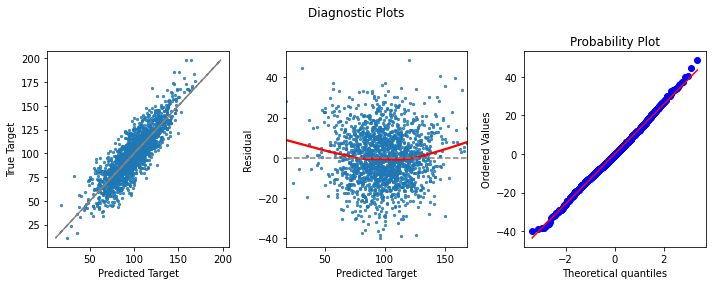

In [245]:
diagnostic_plots(fit.fittedvalues, y, fit.resid)

In [219]:
df.groupby('Age').agg({'OPS+':'mean','Year':'count', 'PA':'mean'})

,OPS+,Year,PA
Age,,,
19,142.000000,1,494.000000
20,128.857143,7,421.142857
21,104.733333,15,443.466667
22,111.265306,49,432.612245
23,99.053763,93,416.602151
24,98.457516,153,411.496732
25,99.139785,186,433.645161
26,99.446154,195,435.107692
27,99.441026,195,414.071795


In [221]:
df[df['Age']==19]

,Name,first_name,last_name,OPS+,Year,MLB_year,Age,OPS+_last,OPS+_3y_0,PA,...,iz_contact_percent,oz_swing_percent,oz_swing_miss_percent,oz_contact_percent,meatball_swing_percent,whiff_percent,swing_percent,popups_percent,hp_to_1b,sprint_speed
1291,Juan Soto,Juan,Soto,142.0,2018,0,19,NaN,NaN,494,...,80.6,18.2,32.6,66.8,77.9,22.1,39.0,5.1,4.21,27.2


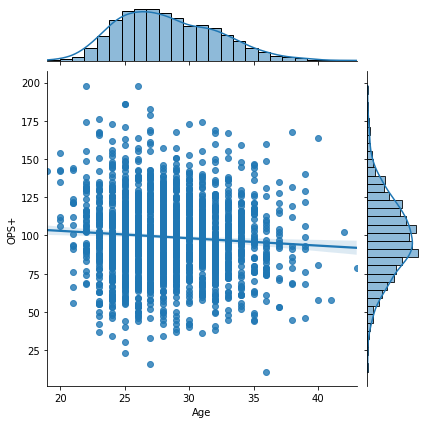

In [227]:
sns.jointplot(x=df['Age'], y=df['OPS+'], kind='reg')

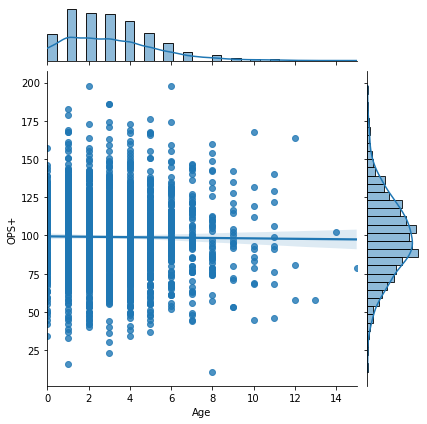

In [253]:
sns.jointplot(x=df['Age'].map(lambda x : abs(x-28)), y=df['OPS+'], kind='reg')

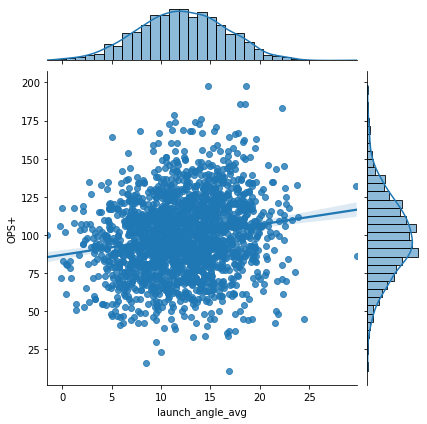

In [224]:
sns.jointplot(x=df['launch_angle_avg'], y=df['OPS+'], kind='reg')

In [247]:
df[df['last_name']=='Altuve']

,Name,first_name,last_name,OPS+,Year,MLB_year,Age,OPS+_last,OPS+_3y_0,PA,...,iz_contact_percent,oz_swing_percent,oz_swing_miss_percent,oz_contact_percent,meatball_swing_percent,whiff_percent,swing_percent,popups_percent,hp_to_1b,sprint_speed
137,Jose Altuve,Jose,Altuve,125.0,2015,4,25,135.0,108.333333,689,...,92.8,34.6,20.1,79.4,80.6,11.3,51.7,7.2,4.11,28.5
138,Jose Altuve,Jose,Altuve,155.0,2016,5,26,125.0,116.333333,717,...,89.2,30.9,25.1,74.5,78.7,15.3,48.6,4.3,4.16,28.4
139,Jose Altuve,Jose,Altuve,160.0,2017,6,27,155.0,138.333333,662,...,89.5,32.0,27.6,72.0,72.2,16.8,47.8,5.1,4.13,28.4
140,Jose Altuve,Jose,Altuve,130.0,2018,7,28,160.0,146.666667,599,...,88.2,30.2,29.5,69.9,76.0,17.9,47.4,3.9,4.13,28.1
141,Jose Altuve,Jose,Altuve,132.0,2019,8,29,130.0,148.333333,548,...,83.1,30.6,30.8,67.3,69.9,20.4,47.6,7.8,4.07,28.6


In [257]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Lasso, LassoCV, Ridge, RidgeCV
from sklearn.metrics import r2_score
import statsmodels.api as sm
import statsmodels.formula.api as smf 


In [254]:
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   OPS+   R-squared:                       0.736
Model:                            OLS   Adj. R-squared:                  0.731
Method:                 Least Squares   F-statistic:                     139.1
Date:                Thu, 23 Sep 2021   Prob (F-statistic):               0.00
Time:                        13:30:44   Log-Likelihood:                -7083.2
No. Observations:                1781   AIC:                         1.424e+04
Df Residuals:                    1745   BIC:                         1.444e+04
Df Model:                          35                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                   -566.3253    634.313     -0.893      0.372   -1810.419     677.768
MLB_year                   0.2286      0.310      0.738      0.461      -0.379       0.836
Age                        0.1805      0.188      0.960      0.337      -0.188       0.550
OPS+_last                  0.0260      0.013      2.002      0.045       0.001       0.051
OPS+_3y_0                  0.0143      0.015      0.954      0.340      -0.015       0.044
PA                         0.0210      0.003      8.330      0.000       0.016       0.026
PA_cum_0                  -0.0013      0.000     -2.887      0.004      -0.002      -0.000
p/pa                       0.8501      2.531      0.336      0.737      -4.114       5.814
EV                         0.4724      0.367      1.287      0.198      -0.247       1.192
HardH%                     0.5082      0.113      4.496      0.000       0.286       0.730
launch_angle_avg           0.6242      0.311      2.007      0.045       0.014       1.234
sweet_spot_percent         1.2637      0.150      8.450      0.000       0.970       1.557
LD%                        0.0241      0.395      0.061      0.951      -0.751       0.799
GB%                       -0.9039      0.366     -2.472      0.014      -1.621      -0.187
FB%                       -0.8582      0.402     -2.134      0.033      -1.647      -0.070
GB/FB                      2.9676      1.245      2.385      0.017       0.527       5.408
Pull%                      4.2739      6.296      0.679      0.497      -8.075      16.623
Cent%                      4.2386      6.298      0.673      0.501      -8.114      16.591
Oppo%                      4.5063      6.296      0.716      0.474      -7.842      16.855
SO/W                      -3.6254      0.363     -9.990      0.000      -4.337      -2.914
GO/AO                      0.7533      2.558      0.295      0.768      -4.264       5.770
IP%                        0.6802      0.133      5.130      0.000       0.420       0.940
HR/FB                      3.4716      0.124     28.032      0.000       3.229       3.715
IF/FB                      0.1270      0.208      0.611      0.541      -0.280       0.534
z_swing_percent            1.0211      0.254      4.014      0.000       0.522       1.520
z_swing_miss_percent       1.9785      0.861      2.299      0.022       0.291       3.666
iz_contact_percent         0.9678      0.687      1.408      0.159      -0.380       2.316
oz_swing_percent           1.0142      0.370      2.741      0.006       0.288       1.740
oz_swing_miss_percent     -0.1390      0.544     -0.255      0.799      -1.207       0.929
oz_contact_percent        -0.3719      0.501     -0.742      0.458      -1.354       0.611
meatball_swing_percent     0.0190      0.074      0.255      0.799      -0.127  

In [258]:
lr_model_ridge = Ridge(alpha = 1000000000000)
lr_model_ridge.fit(X, y)

list(zip(X.columns, lr_model_ridge.coef_))

[('MLB_year', -3.008563084766248e-10),
 ('Age', -1.1104986981764693e-08),
 ('OPS+_last', 4.5931662792824123e-07),
 ('OPS+_3y_0', 4.310484421965975e-07),
 ('PA', 3.571610595350248e-06),
 ('PA_cum_0', 8.701202853880334e-06),
 ('p/pa', 1.8166158026772077e-09),
 ('EV', 5.85487314919017e-08),
 ('HardH%', 1.9369824482795515e-07),
 ('launch_angle_avg', 3.278991458113781e-08),
 ('sweet_spot_percent', 7.10652156549026e-08),
 ('LD%', 4.3604681847591976e-08),
 ('GB%', -6.526376658098136e-08),
 ('FB%', 5.624321254462738e-08),
 ('GB/FB', -8.472411918775837e-09),
 ('Pull%', 3.0129829447562674e-08),
 ('Cent%', -6.895374551387791e-09),
 ('Oppo%', -2.3208615802268982e-08),
 ('SO/W', -2.3536835400172945e-08),
 ('GO/AO', -2.0569082780489228e-09),
 ('IP%', -5.935395012240802e-08),
 ('HR/FB', 1.2418483600871413e-07),
 ('IF/FB', -3.7558576709635464e-08),
 ('z_swing_percent', 5.100368668207586e-09),
 ('z_swing_miss_percent', 3.411927514840548e-09),
 ('iz_contact_percent', 6.487788439015728e-09),
 ('oz_swing_

In [259]:
lr_model_lasso = Lasso(alpha = 100000)
lr_model_lasso.fit(X, y)

list(zip(X.columns, lr_model_lasso.coef_))

[('MLB_year', -0.0),
 ('Age', -0.0),
 ('OPS+_last', 0.0),
 ('OPS+_3y_0', 0.0),
 ('PA', 0.0),
 ('PA_cum_0', 0.0),
 ('p/pa', 0.0),
 ('EV', 0.0),
 ('HardH%', 0.0),
 ('launch_angle_avg', 0.0),
 ('sweet_spot_percent', 0.0),
 ('LD%', 0.0),
 ('GB%', -0.0),
 ('FB%', 0.0),
 ('GB/FB', -0.0),
 ('Pull%', 0.0),
 ('Cent%', -0.0),
 ('Oppo%', -0.0),
 ('SO/W', -0.0),
 ('GO/AO', -0.0),
 ('IP%', -0.0),
 ('HR/FB', 0.0),
 ('IF/FB', -0.0),
 ('z_swing_percent', 0.0),
 ('z_swing_miss_percent', 0.0),
 ('iz_contact_percent', 0.0),
 ('oz_swing_percent', -0.0),
 ('oz_swing_miss_percent', -0.0),
 ('oz_contact_percent', 0.0),
 ('meatball_swing_percent', 0.0),
 ('whiff_percent', 0.0),
 ('swing_percent', -0.0),
 ('popups_percent', -0.0),
 ('hp_to_1b', 0.0),
 ('sprint_speed', -0.0)]

In [273]:
lr_model_ridge.predict(X).max()

98.90847377927645

In [276]:
fit.predict().max()

168.48757245011032